In [1]:
import ee
import geemap
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from sklearn.cluster import KMeans

ee.Authenticate()

ee.Initialize(project='general-porpose')

geometry = ee.Geometry.Polygon(
    [[[-56.19933935093308, -15.570030087161426],
      [-56.236418208354955, -15.63616420965171],
      [-56.173246821636205, -15.75515175246836],
      [-56.110075434917455, -15.760438474073672],
      [-56.079863032573705, -15.701615952093842],
      [-56.002958735698705, -15.706243058621192],
      [-55.91712804722214, -15.675173328966476],
      [-55.92468114780808, -15.622277812891932],
      [-55.98510595249558, -15.587888400489534],
      [-56.00982519077683, -15.527031492578372],
      [-56.052397212261205, -15.503213026342152],
      [-56.09290929722214, -15.518430696875168],
      [-56.13616796421433, -15.537616594867629]]])


Extraindo RGB de 2013


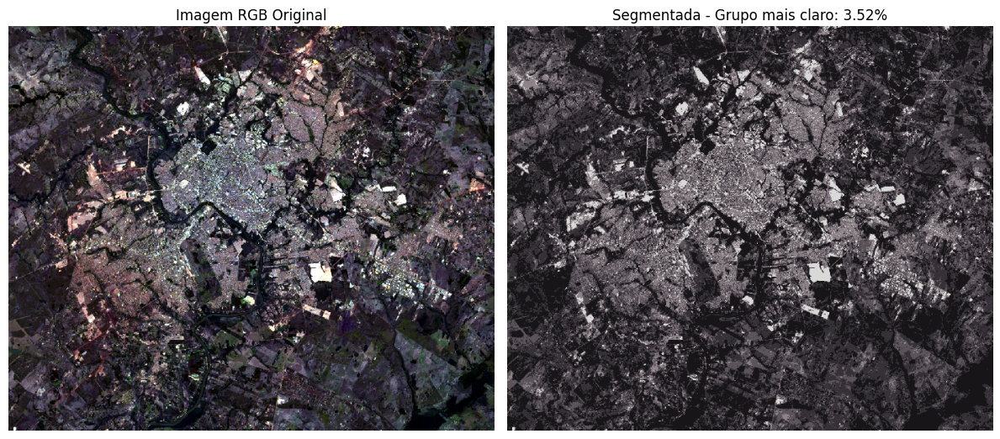

Extraindo RGB de 2014


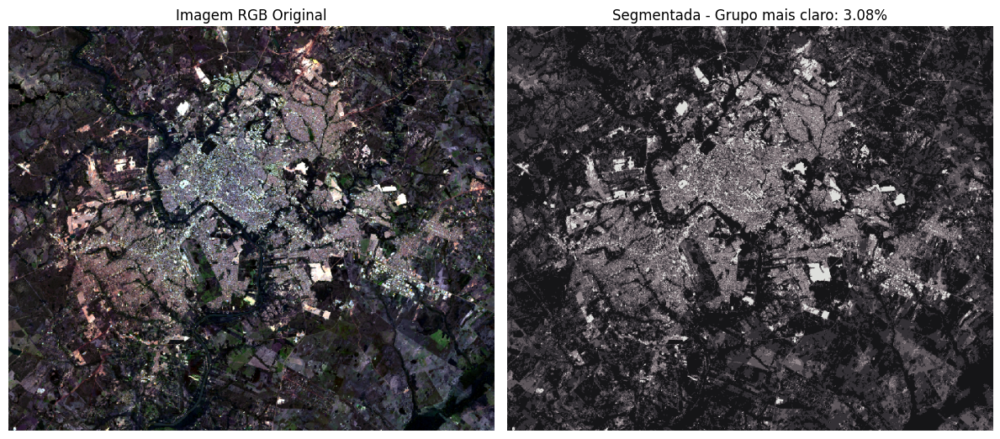

Extraindo RGB de 2015


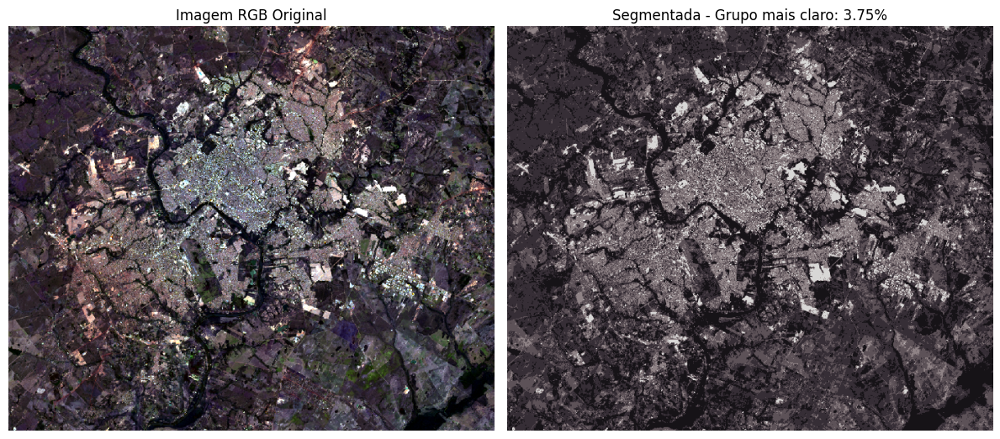

Extraindo RGB de 2016


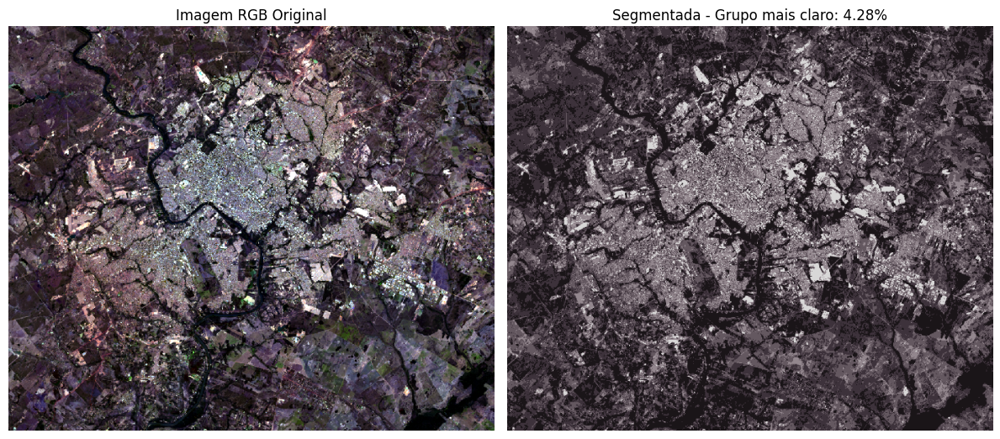

Extraindo RGB de 2017


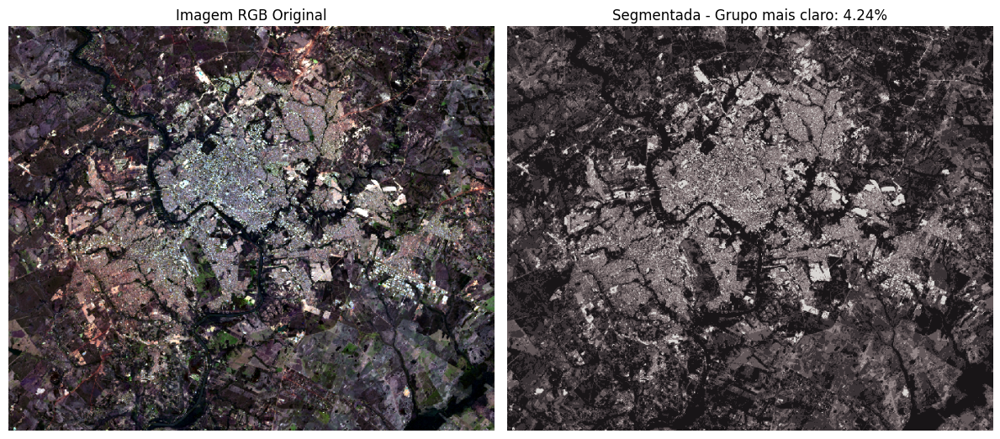

Extraindo RGB de 2018


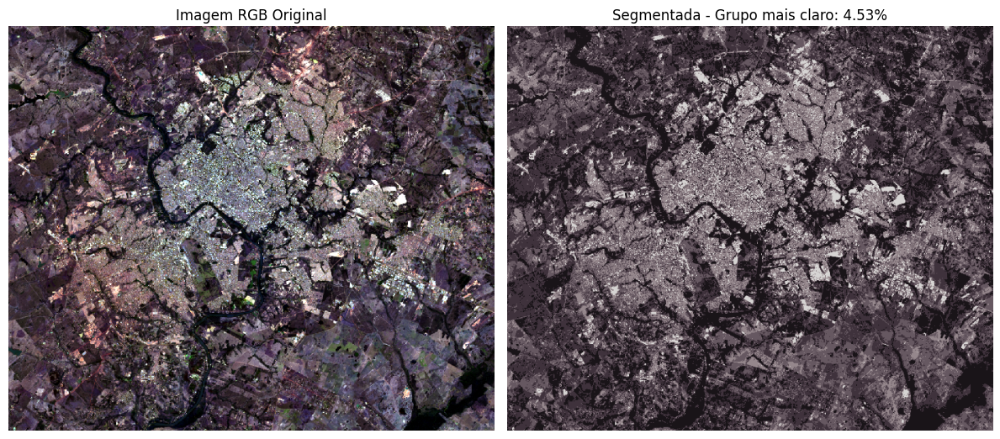

Extraindo RGB de 2019


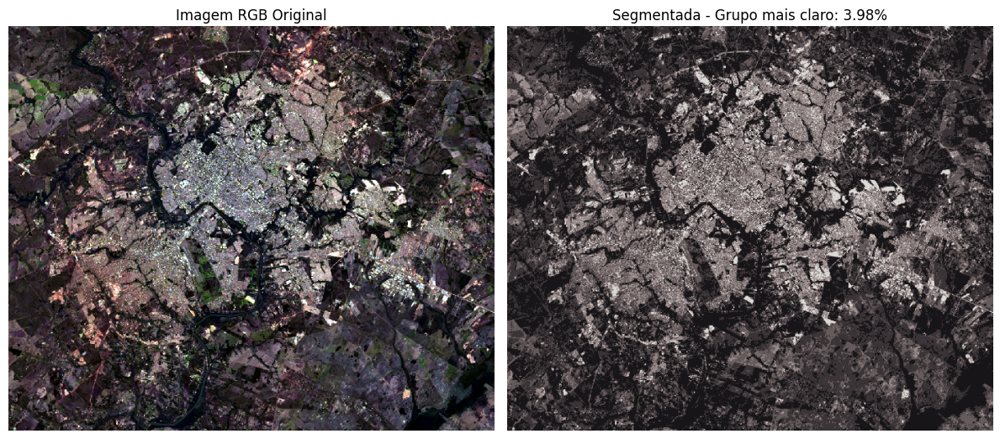

Extraindo RGB de 2020


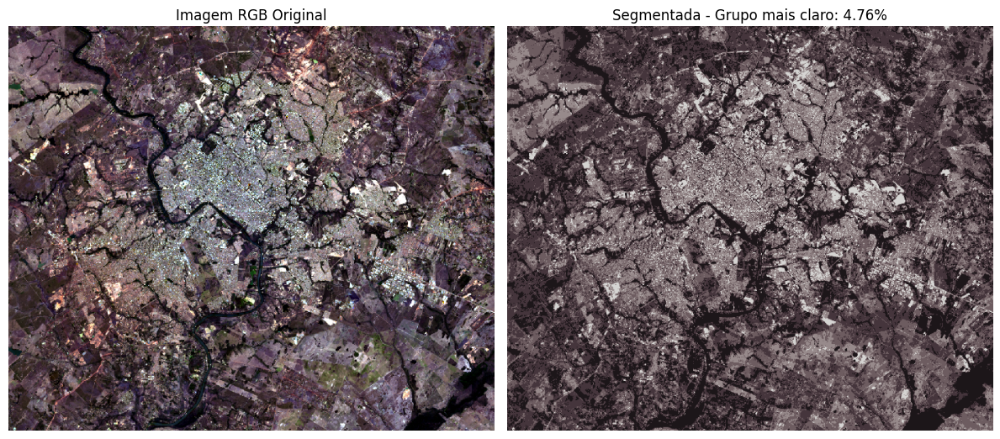

Extraindo RGB de 2021


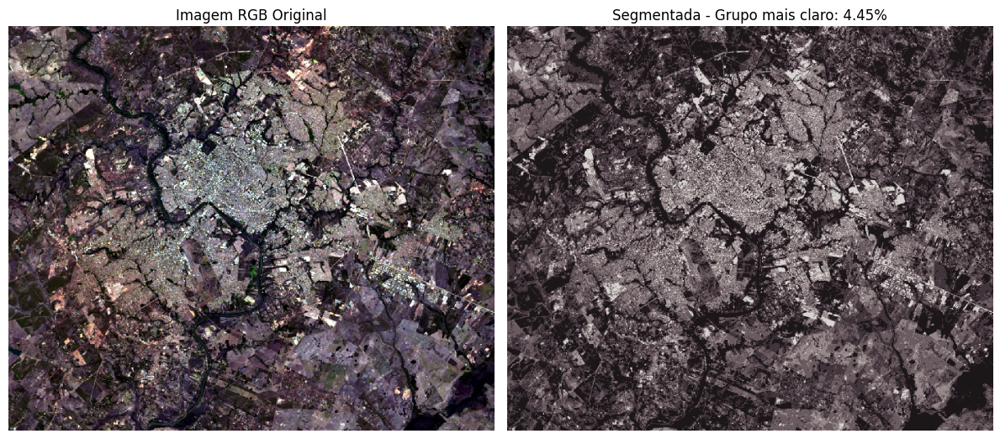

Extraindo RGB de 2022


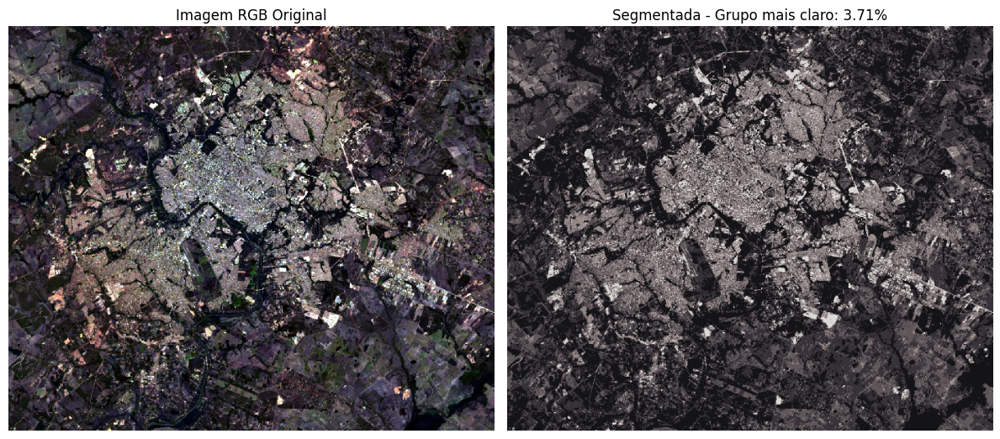

Extraindo RGB de 2023


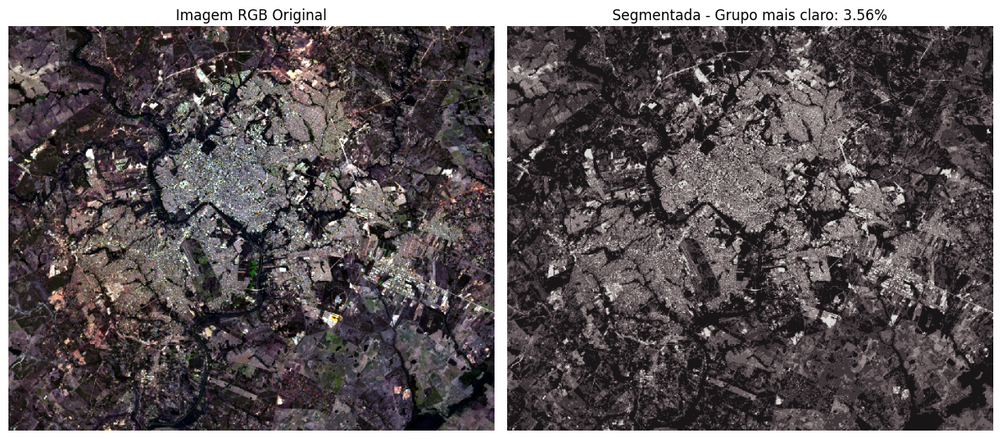

Extraindo RGB de 2024


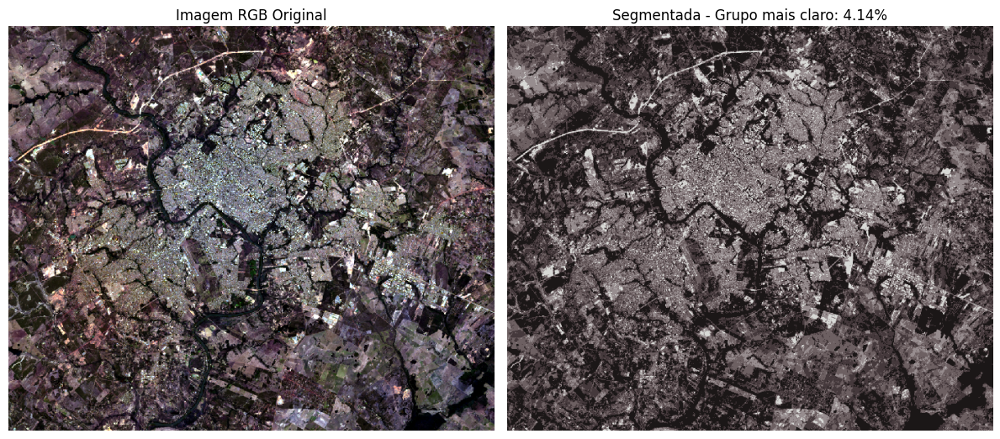

In [ ]:

bandas = {
    'LANDSAT_8': {'NIR': 'SR_B5', 'RED': 'SR_B4', 'BLUE': 'SR_B2','GREEN':'SR_B3', 'SWIR': 'SR_B6'},
    'LANDSAT_9': {'NIR': 'SR_B5', 'RED': 'SR_B4', 'BLUE': 'SR_B2', 'SWIR': 'SR_B6'},
    'default':   {'NIR': 'SR_B5', 'RED': 'SR_B4', 'BLUE': 'SR_B2', 'SWIR': 'SR_B6','GREEN':'SR_B3',},
}

# bandas = {
#     'LANDSAT_8': {
#         'NIR': 'B5',
#         'RED': 'B4',
#         'BLUE': 'B2',
#         'GREEN':'B3',
#         'SWIR': 'B6'
#     },
#     'default': {
#         'NIR': 'B5',
#         'RED': 'B4',
#         'BLUE': 'B2',
#         'GREEN':'B3',
#         'SWIR': 'B6'
#     }
# }

def get_band(bands_dict, band_name, sensor):
    return bands_dict.get(sensor, bands_dict['default'])[band_name]

def normalizar_rgb_auto(rgb_array):
    """Normaliza cada banda usando o percentil 2–98."""
    rgb_array = rgb_array.astype(np.float32)
    for i in range(3):
        banda = rgb_array[:, :, i]
        p2, p98 = np.nanpercentile(banda, [1, 99])
        rgb_array[:, :, i] = np.clip((banda - p2) / (p98 - p2), 0, 1)
    return (rgb_array * 255).astype(np.uint8)

def mask_clouds(image):
    qa = image.select('QA_PIXEL')
    cloud_bit = 1 << 3
    shadow_bit = 1 << 4
    mask = qa.bitwiseAnd(cloud_bit).eq(0).And(qa.bitwiseAnd(shadow_bit).eq(0))
    return image.updateMask(mask)

def mostrar_cores_grupos(rgb_image, n_clusters=5):
    h, w, c = rgb_image.shape
    pixels = rgb_image.reshape(-1, 3)
    valid_pixels = pixels[~np.isnan(pixels).any(axis=1)]

    kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(valid_pixels)
    cores = kmeans.cluster_centers_.astype(np.uint8)
    
    # Brilho médio (R+G+B)/3
    brilho_medio = cores.mean(axis=1)
    grupo_mais_claro = np.argmax(brilho_medio)

    # Classificar todos os pixels válidos
    full_pixels = rgb_image.reshape(-1, 3)
    mask_validos = ~np.isnan(full_pixels).any(axis=1)

    segmentos_validos = kmeans.predict(full_pixels[mask_validos])
    total_validos = len(segmentos_validos)
    total_mais_claro = np.sum(segmentos_validos == grupo_mais_claro)

    proporcao = total_mais_claro / total_validos if total_validos > 0 else np.nan

    # Imagem segmentada
    segmentos = np.zeros_like(full_pixels)
    segmentos[~mask_validos] = [0, 0, 0]
    segmentos[mask_validos] = cores[segmentos_validos]
    imagem_segmentada = segmentos.reshape(h, w, 3)

    # Mostrar lado a lado
    fig, axs = plt.subplots(1, 2, figsize=(12, 6))
    axs[0].imshow(rgb_image)
    axs[0].set_title("Imagem RGB Original")
    axs[0].axis('off')
    axs[1].imshow(imagem_segmentada)
    axs[1].set_title(f"Segmentada - Grupo mais claro: {proporcao:.2%}")
    axs[1].axis('off')
    plt.tight_layout()
    plt.show()

    return proporcao


# Main
colecao_merged = ee.ImageCollection("LANDSAT/LC08/C02/T1_L2")
# colecao_merged = ee.ImageCollection("LANDSAT/LC08/C02/T1")
proporcoes_por_ano = []
for ano in range(2013, 2025):
    try:
        colecao = colecao_merged \
            .filterBounds(geometry) \
            .filterDate(f"{ano}-07-01", f"{ano}-08-28") \
            .filter(ee.Filter.lt('CLOUD_COVER', 30)) \
            .map(mask_clouds)

        imagem = colecao.sort('CLOUD_COVER').first()

        if imagem is None or imagem.getInfo() is None:
            continue

        sensor = ee.String(imagem.get('SPACECRAFT_ID')).getInfo()
        red = get_band(bandas, 'RED', sensor)
        green = get_band(bandas, 'GREEN', sensor)
        blue = get_band(bandas, 'BLUE', sensor)

        rgb_imagem = imagem.select([red, green, blue])

        print(f"Extraindo RGB de {ano}")
        rgb_array = geemap.ee_to_numpy(rgb_imagem, region=geometry, scale=50)

        if rgb_array is None or rgb_array.shape[-1] != 3:
            print(f"Imagem inválida em {ano}")
            continue

        rgb_norm =  normalizar_rgb_auto(rgb_array)
        proporcao = mostrar_cores_grupos(rgb_norm, n_clusters=5)
        proporcoes_por_ano.append({'ano': ano, 'proporcao_mais_claro': proporcao})

    except Exception as e:
        print(f"Erro ao processar ano {ano}: {e}")

In [15]:
proporcoes_por_ano

[{'ano': 2013, 'proporcao_mais_claro': np.float64(0.03523114355231143)},
 {'ano': 2014, 'proporcao_mais_claro': np.float64(0.030813164297605326)},
 {'ano': 2015, 'proporcao_mais_claro': np.float64(0.03753361505954668)},
 {'ano': 2016, 'proporcao_mais_claro': np.float64(0.04276860033294916)},
 {'ano': 2017, 'proporcao_mais_claro': np.float64(0.042394672813420416)},
 {'ano': 2018, 'proporcao_mais_claro': np.float64(0.045288769368677165)},
 {'ano': 2019, 'proporcao_mais_claro': np.float64(0.039782302471507235)},
 {'ano': 2020, 'proporcao_mais_claro': np.float64(0.04762453579203483)},
 {'ano': 2021, 'proporcao_mais_claro': np.float64(0.04450761941349725)},
 {'ano': 2022, 'proporcao_mais_claro': np.float64(0.03712127032910744)},
 {'ano': 2023, 'proporcao_mais_claro': np.float64(0.035571776155717764)},
 {'ano': 2024, 'proporcao_mais_claro': np.float64(0.041413753361505955)}]